<a href="https://colab.research.google.com/github/SharmaAshwini/UNT/blob/main/Methods%20in%20Empirical%20Analysis/Exercise_6_Image_ColorFeatures_Histogram.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## ICE-6 Color features and histogram
Please download the following images for the ICE-6:<br>
https://drive.google.com/file/d/136KacYJQZ3ShMSDndqgzohTlTPrfKuma/view?usp=sharing

In [ ]:
#from google.colab import drive

In [ ]:
!gdown --folder 'https://drive.google.com/drive/folders/1XBRuVy7V4PNwYkDGYsP9Tv5f1PEh0EKB?usp=sharing'

Retrieving folder list
Processing file 1QQX3iu82CNNCWp3wYgtufs_ejuE4jyg3 boy.jpg
Processing file 11E_9TJAA2JnSAvIoXLdHz8I_RjjGHDTQ eggs.jpg
Processing file 1H8KjxC15MNrf1tLlm0Xs6mVuWFyVr81B Nepal.jpg
Retrieving folder list completed
Building directory structure
Building directory structure completed
Downloading...
From: https://drive.google.com/uc?id=1QQX3iu82CNNCWp3wYgtufs_ejuE4jyg3
To: /content/images/boy.jpg
100% 63.4k/63.4k [00:00<00:00, 58.3MB/s]
Downloading...
From: https://drive.google.com/uc?id=11E_9TJAA2JnSAvIoXLdHz8I_RjjGHDTQ
To: /content/images/eggs.jpg
100% 593k/593k [00:00<00:00, 145MB/s]
Downloading...
From: https://drive.google.com/uc?id=1H8KjxC15MNrf1tLlm0Xs6mVuWFyVr81B
To: /content/images/Nepal.jpg
100% 394k/394k [00:00<00:00, 108MB/s]
Download completed


## (Tutorial) Dominant colors
Please refer to the following link to learn how to extract dominant colors of a given image:<br>
https://www.dataquest.io/blog/tutorial-colors-image-clustering-python/

## Example 1. Extracting dominant colors

In [ ]:
!pip install utils

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# import the necessary packages

from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import argparse
import utils
import cv2

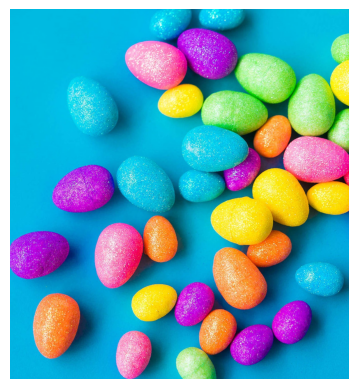

In [ ]:
# load the image and convert it from BGR to RGB so that
# we can dispaly it with matplotlib
image = cv2.imread("images/eggs.jpg")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.figure()
plt.axis("off")
plt.imshow(image)

In [ ]:
# reshape the image to proper version for the following processing
image = image.reshape((image.shape[0] * image.shape[1], 3))

In [ ]:
# cluster the pixel intensities
clt = KMeans(n_clusters = 10)
clt.fit(image)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(n_clusters=10)

In [ ]:
# import the necessary packages
import numpy as np
import cv2
def centroid_histogram(clt):
# grab the number of different clusters and create a histogram
# based on the number of pixels assigned to each cluster
    numLabels = np.arange(0, len(np.unique(clt.labels_)) + 1)
    (hist, _) = np.histogram(clt.labels_, bins = numLabels)
# normalize the histogram, such that it sums to one
    hist = hist.astype("float")
    hist /= hist.sum()
# return the histogram
    return hist

In [ ]:
def plot_colors(hist, centroids):
# initialize the bar chart representing the relative frequency
# of each of the colors
    bar = np.zeros((50, 300, 3), dtype = "uint8")
    startX = 0
# loop over the percentage of each cluster and the color of
# each cluster
    for (percent, color) in zip(hist, centroids):
# plot the relative percentage of each cluster
        endX = startX + (percent * 300)
        cv2.rectangle(bar, (int(startX), 0), (int(endX), 50),
            color.astype("uint8").tolist(), -1)
        startX = endX

# return the bar chart
    return bar

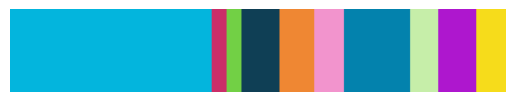

In [ ]:
# build a histogram of clusters and then create a figure
# representing the number of pixels labeled to each color
hist = centroid_histogram(clt)
bar = plot_colors(hist, clt.cluster_centers_)
# show our color bart
plt.figure()
plt.axis("off")
plt.imshow(bar)
plt.show()

## (Tutorial) Within-Cluster Sum of Square (wcss) and Elbow method
Please refer to the following link to learn Elbow method for optimal number of clusters selecting:<br>
https://www.analyticsvidhya.com/blog/2021/01/in-depth-intuition-of-k-means-clustering-algorithm-in-machine-learning/

## Task 1. Using the Elbow method to select the optimal number of clusters for the three images in your downloaded zip file
1. Selecting the optimal number of clusters using Elbow method
2. Visualizing the histogram of clusters as shown in example 1 with the optimal number of clusters

In [ ]:
# write you code here


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import sklearn

In [ ]:
from sklearn.cluster import KMeans
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 42)
    kmeans.fit(image)
    wcss.append(kmeans.inertia_)


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

Text(0.5, 0, 'Number of clusters')

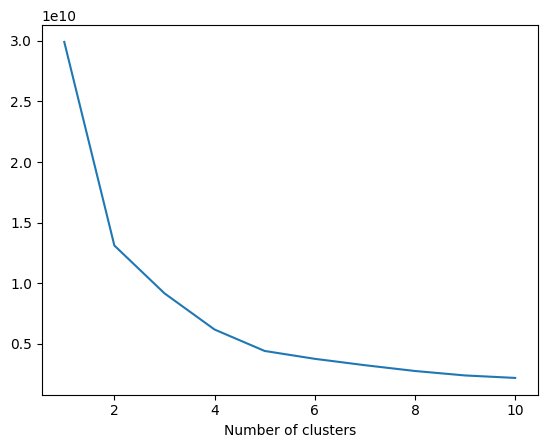

In [ ]:
plt.plot(range(1, 11), wcss)
plt.xlabel('Number of clusters')

In [ ]:
#selecting optimal number of clusters using Elbow method as "5" from above line chart
clt = KMeans(n_clusters = 5)
clt.fit(image)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(n_clusters=5)

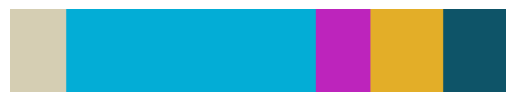

In [ ]:
# build a histogram of clusters and then create a figure
# representing the number of pixels labeled to each color
hist = centroid_histogram(clt)
bar = plot_colors(hist, clt.cluster_centers_)
# show our color bart
plt.figure()
plt.axis("off")
plt.imshow(bar)
plt.show()

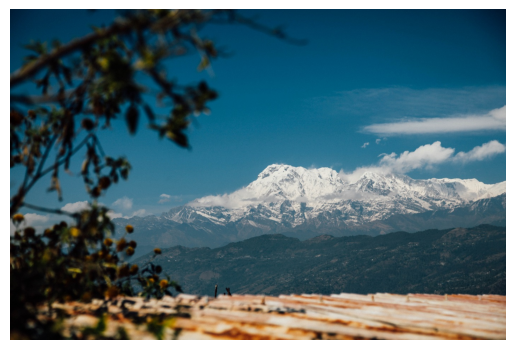

In [ ]:
#Image 2

image = cv2.imread("images/Nepal.jpg")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.figure()
plt.axis("off")
plt.imshow(image)

# reshape the image to proper version for the following processing
image = image.reshape((image.shape[0] * image.shape[1], 3))





/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

Text(0.5, 0, 'Number of clusters')

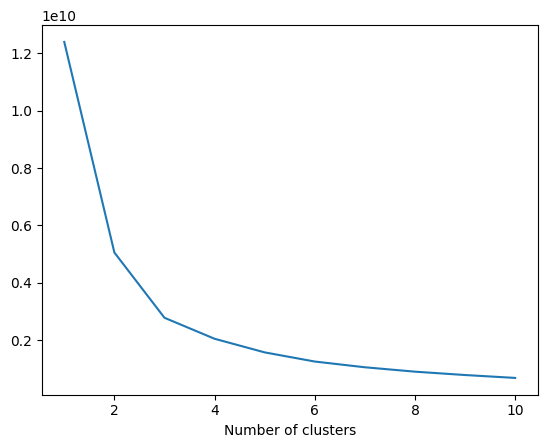

In [ ]:
from sklearn.cluster import KMeans
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 42)
    kmeans.fit(image)
    wcss.append(kmeans.inertia_)

plt.plot(range(1, 11), wcss)
plt.xlabel('Number of clusters')

In [ ]:
#selecting optimal number of clusters using Elbow method as "3" from above line chart
clt = KMeans(n_clusters = 3)
clt.fit(image)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(n_clusters=3)

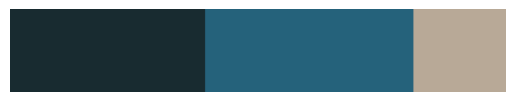

In [ ]:
# build a histogram of clusters and then create a figure
# representing the number of pixels labeled to each color
hist = centroid_histogram(clt)
bar = plot_colors(hist, clt.cluster_centers_)
# show our color bart
plt.figure()
plt.axis("off")
plt.imshow(bar)
plt.show()

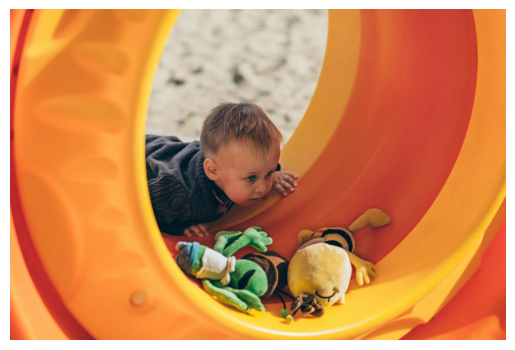

In [ ]:
#Image 3

image = cv2.imread("images/boy.jpg")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.figure()
plt.axis("off")
plt.imshow(image)

# reshape the image to proper version for the following processing
image = image.reshape((image.shape[0] * image.shape[1], 3))





/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

Text(0.5, 0, 'Number of clusters')

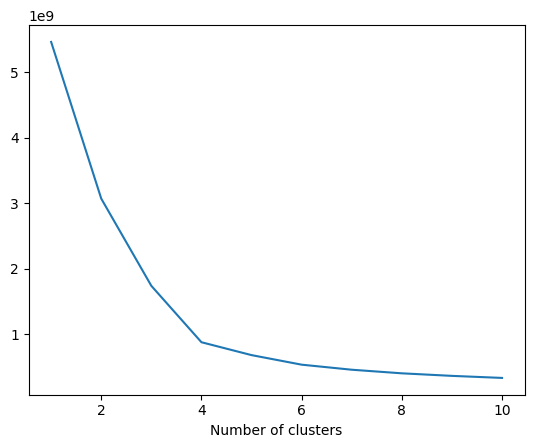

In [ ]:
from sklearn.cluster import KMeans
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 42)
    kmeans.fit(image)
    wcss.append(kmeans.inertia_)

plt.plot(range(1, 11), wcss)
plt.xlabel('Number of clusters')

In [ ]:
#selecting optimal number of clusters using Elbow method as "4" from above line chart
clt = KMeans(n_clusters = 4)
clt.fit(image)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(n_clusters=4)

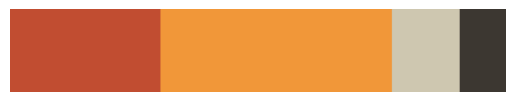

In [ ]:
# build a histogram of clusters and then create a figure
# representing the number of pixels labeled to each color
hist = centroid_histogram(clt)
bar = plot_colors(hist, clt.cluster_centers_)
# show our color bart
plt.figure()
plt.axis("off")
plt.imshow(bar)
plt.show()

## Question 1. According to the Elbow method, how to choose the optimal number of clusters?

**Answer to Q1**: type your answer here


---

When we plot the WCSS with the K value, the plot looks like an Elbow. As the number of clusters increases, the WCSS value will start to decrease. WCSS value is largest when K = 1. When we analyze the graph, we can see that the graph will rapidly change at a point and thus creating an elbow shape. From this point, the graph moves almost parallel to the X-axis. The K value corresponding to this point is the optimal value of K or an optimal number of clusters.

## (Tutorial) Histogram Equalization
Please refer to the following link to learn the histogram equalization:<br>
https://medium.com/@kyawsawhtoon/a-tutorial-to-histogram-equalization-497600f270e2 <br> and
https://hypjudy.github.io/2017/03/19/dip-histogram-equalization/

## Example 2. Histogram equalization on gray image

Original Image


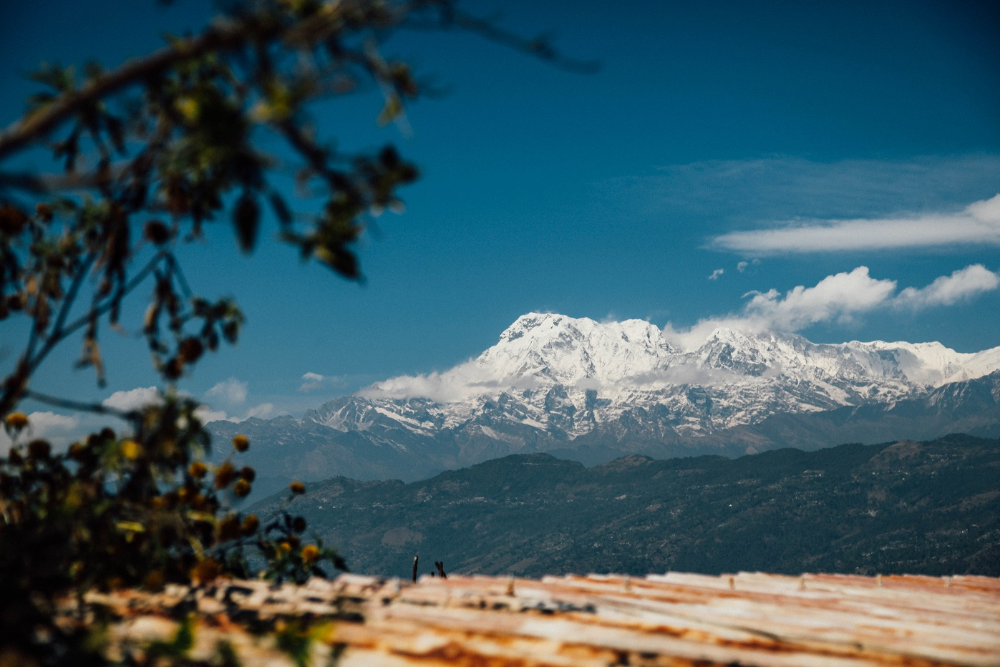

Gray Image


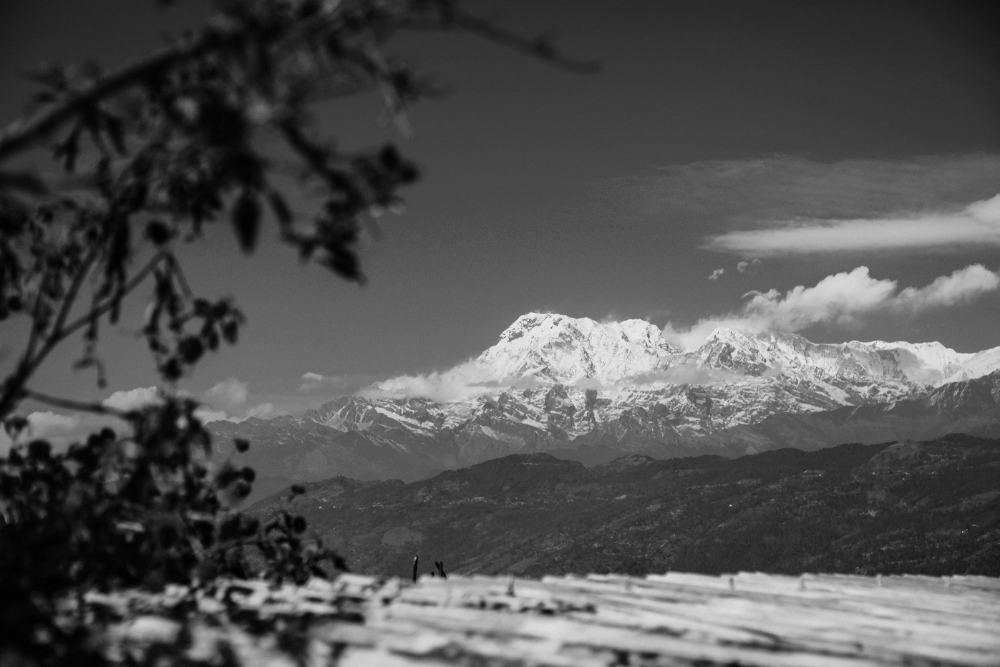

In [ ]:
from google.colab.patches import cv2_imshow

img = cv2.imread('images/Nepal.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
print("Original Image")
cv2_imshow(img)
print("Gray Image")
cv2_imshow(gray)
cv2.waitKey(0)
cv2.destroyAllWindows()

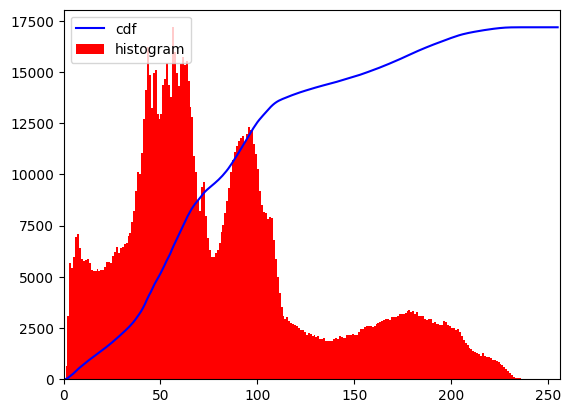

In [ ]:
hist,bins = np.histogram(gray.flatten(),256,[0,256])
cdf = hist.cumsum()
cdf_normalized = cdf * float(hist.max()) / cdf.max()
plt.plot(cdf_normalized, color = 'b')
plt.hist(gray.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.legend(('cdf','histogram'), loc = 'upper left')
plt.show()

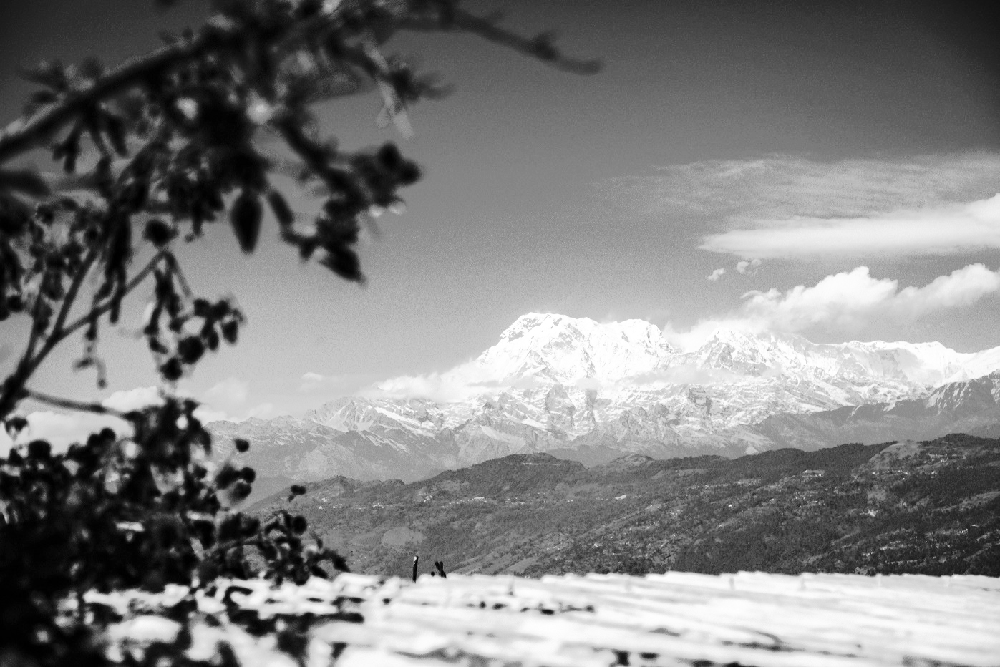

In [ ]:
equ = cv2.equalizeHist(gray)
cv2_imshow(equ)
cv2.waitKey(0)
cv2.destroyAllWindows()

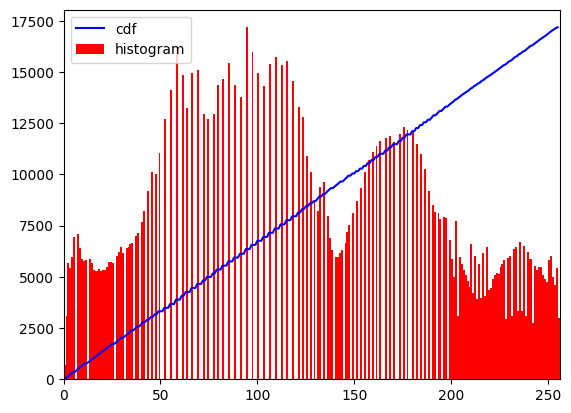

In [ ]:
hist,bins = np.histogram(equ.flatten(),256,[0,256])
cdf = hist.cumsum()
cdf_normalized = cdf * float(hist.max()) / cdf.max()
plt.plot(cdf_normalized, color = 'b')
plt.hist(equ.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.legend(('cdf','histogram'), loc = 'upper left')
plt.show()



```
# This is formatted as code
```

## Task 2. Histogram equalization on color images
1. Apply histogram equalization on the 3 downloaded images
2. Visualize the histograms and the cumulative summation before and after histogram equalization
3. Show the images before and after histogram equalization

###Reference:

https://towardsdatascience.com/histogram-equalization-a-simple-way-to-improve-the-contrast-of-your-image-bcd66596d815

In [ ]:
# write your code here


In [ ]:
def histogram_equalization(img_in):
# segregate color streams
    b,g,r = cv2.split(img_in)
    h_b, bin_b = np.histogram(b.flatten(), 256, [0, 256])
    h_g, bin_g = np.histogram(g.flatten(), 256, [0, 256])
    h_r, bin_r = np.histogram(r.flatten(), 256, [0, 256])
# calculate cdf
    cdf_b = np.cumsum(h_b)
    cdf_g = np.cumsum(h_g)
    cdf_r = np.cumsum(h_r)

# mask all pixels with value=0 and replace it with mean of the pixel values
    cdf_m_b = np.ma.masked_equal(cdf_b,0)
    cdf_m_b = (cdf_m_b - cdf_m_b.min())*255/(cdf_m_b.max()-cdf_m_b.min())
    cdf_final_b = np.ma.filled(cdf_m_b,0).astype('uint8')

    cdf_m_g = np.ma.masked_equal(cdf_g,0)
    cdf_m_g = (cdf_m_g - cdf_m_g.min())*255/(cdf_m_g.max()-cdf_m_g.min())
    cdf_final_g = np.ma.filled(cdf_m_g,0).astype('uint8')
    cdf_m_r = np.ma.masked_equal(cdf_r,0)
    cdf_m_r = (cdf_m_r - cdf_m_r.min())*255/(cdf_m_r.max()-cdf_m_r.min())
    cdf_final_r = np.ma.filled(cdf_m_r,0).astype('uint8')
# merge the images in the three channels
    img_b = cdf_final_b[b]
    img_g = cdf_final_g[g]
    img_r = cdf_final_r[r]

    img_out = cv2.merge((img_b, img_g, img_r))
# validation
    equ_b = cv2.equalizeHist(b)
    equ_g = cv2.equalizeHist(g)
    equ_r = cv2.equalizeHist(r)
    equ = cv2.merge((equ_b, equ_g, equ_r))
    #print(equ)
    #cv2.imwrite('output_name.png', equ)
    hist,bins = np.histogram(equ.flatten(),256,[0,256])
    cdf = hist.cumsum()
    cdf_normalized = cdf * float(hist.max()) / cdf.max()
    plt.plot(cdf_normalized, color = 'b')
    plt.hist(equ.flatten(),256,[0,256], color = 'r')
    plt.xlim([0,256])
    plt.legend(('cdf','histogram'), loc = 'upper left')
    plt.title('cum sum after')
    plt.show()

    ##cv2_imshow(img_out)
    ##cv2_imshow(equ)
    ##merge_horizontal = np.hstack((img_out, equ))
    ##cv2_imshow(merge_horizontal)

    return img_out

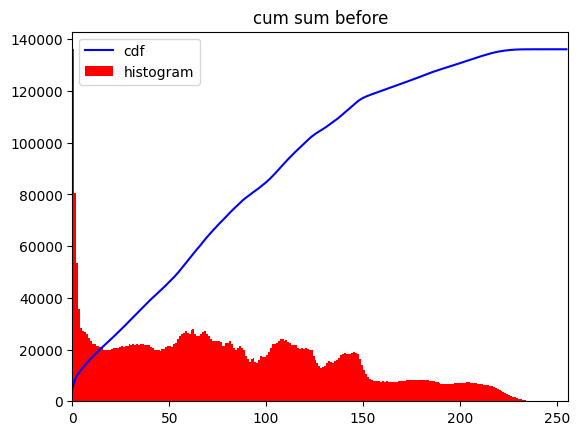

In [ ]:
## Histogram equalization on color images - Image 1
img = cv2.imread('images/Nepal.jpg')

hist,bins = np.histogram(img.flatten(),256,[0,256])
cdf = hist.cumsum()
cdf_normalized = cdf * float(hist.max()) / cdf.max()
plt.plot(cdf_normalized, color = 'b')
plt.hist(img.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.legend(('cdf','histogram'), loc = 'upper left')
plt.title('cum sum before')
plt.show()

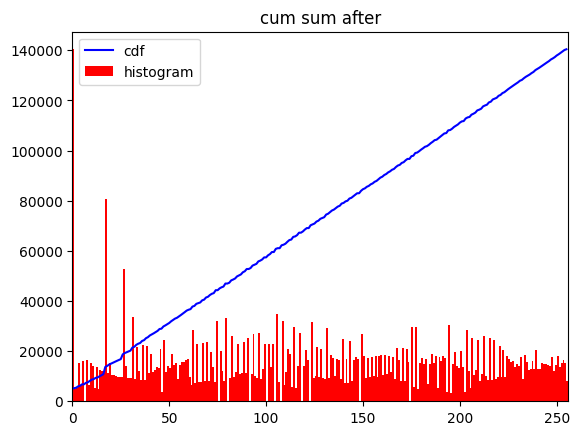

In [ ]:
out_image = histogram_equalization(img)

Original Image


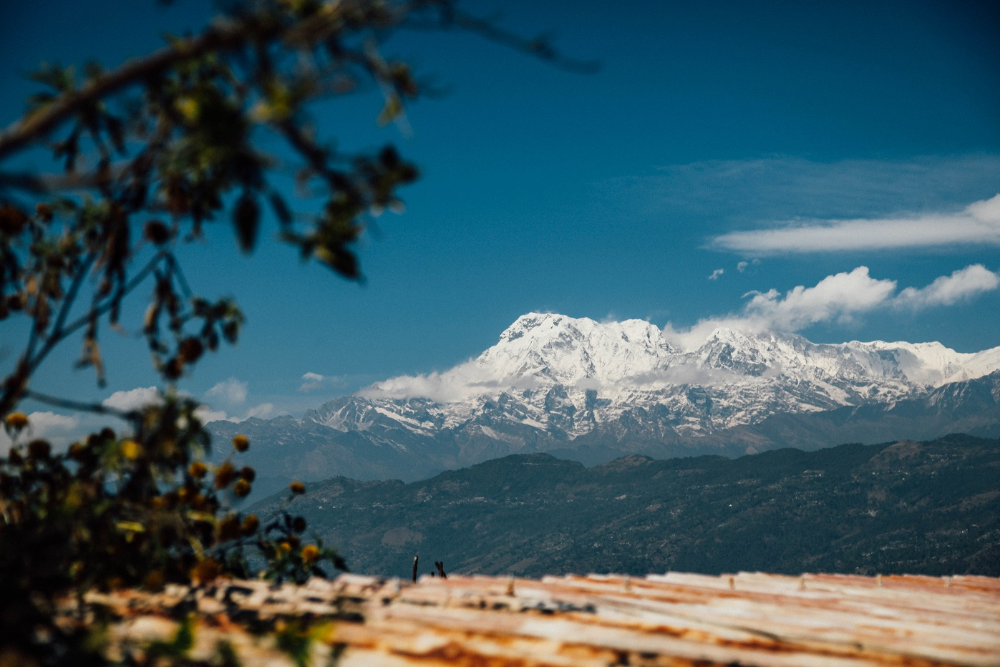

Updated Image


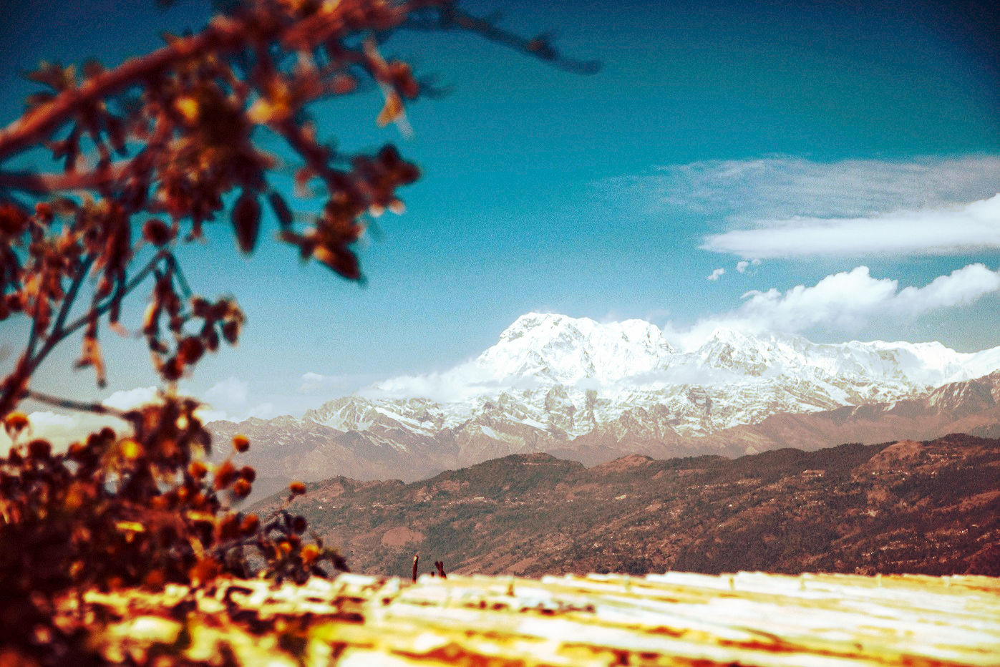

In [ ]:
print("Original Image")
cv2_imshow(img)
print("Updated Image")
cv2_imshow(out_image)

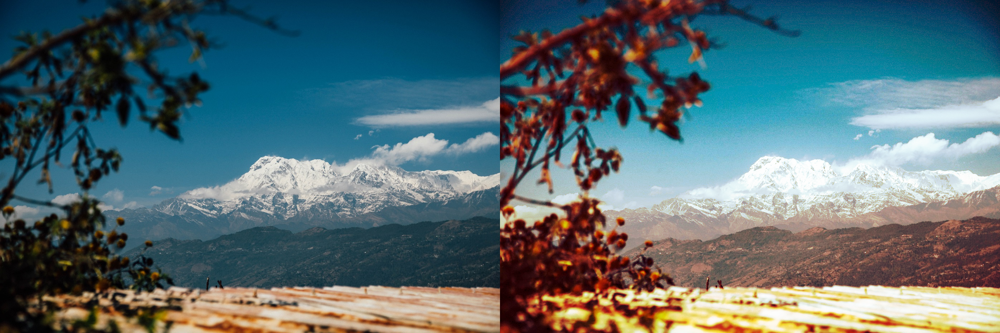

In [ ]:
#side by side comparison
merge_horizontal = np.hstack((img, out_image))
cv2_imshow(merge_horizontal)

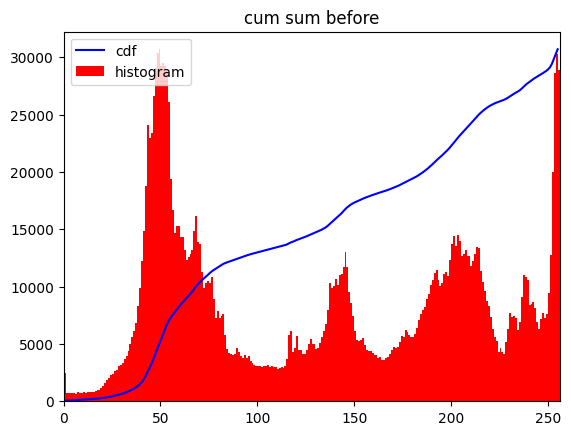

In [ ]:
## Histogram equalization on color images - Image 2
img = cv2.imread('images/boy.jpg')

hist,bins = np.histogram(img.flatten(),256,[0,256])
cdf = hist.cumsum()
cdf_normalized = cdf * float(hist.max()) / cdf.max()
plt.plot(cdf_normalized, color = 'b')
plt.hist(img.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.legend(('cdf','histogram'), loc = 'upper left')
plt.title('cum sum before')
plt.show()

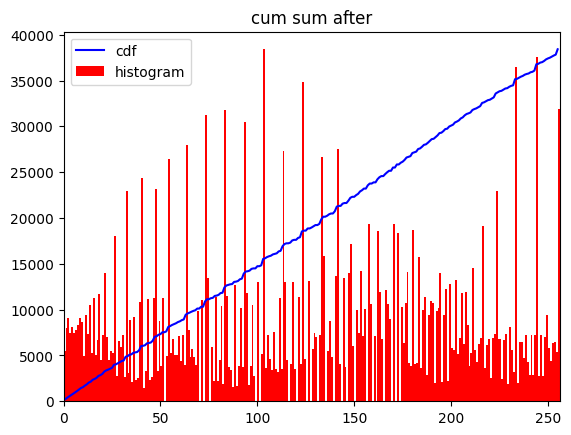

In [ ]:
out_image = histogram_equalization(img)

Original Image


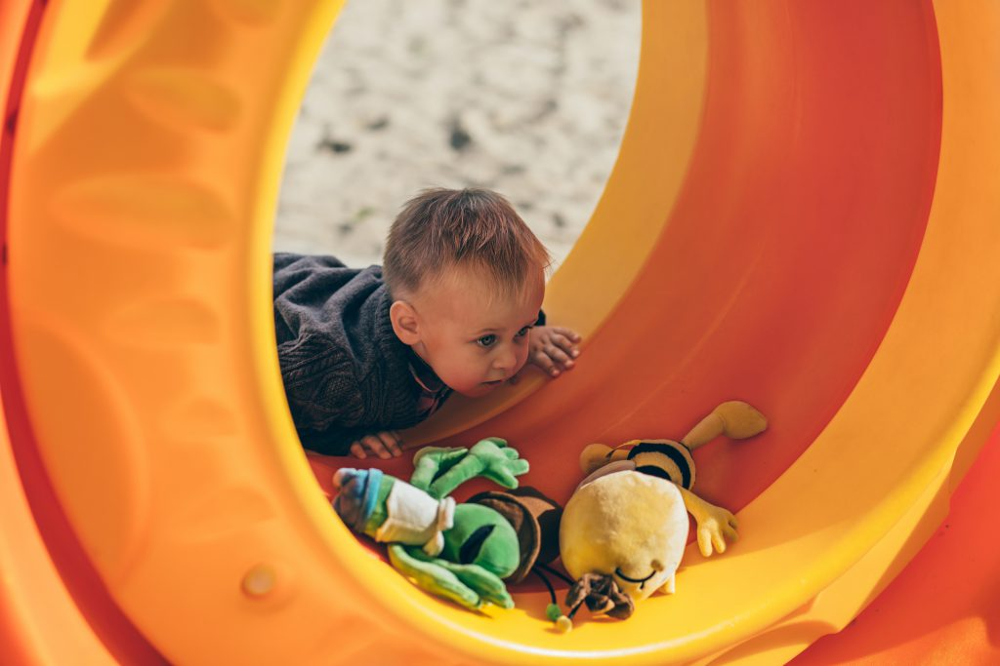

Updated Image


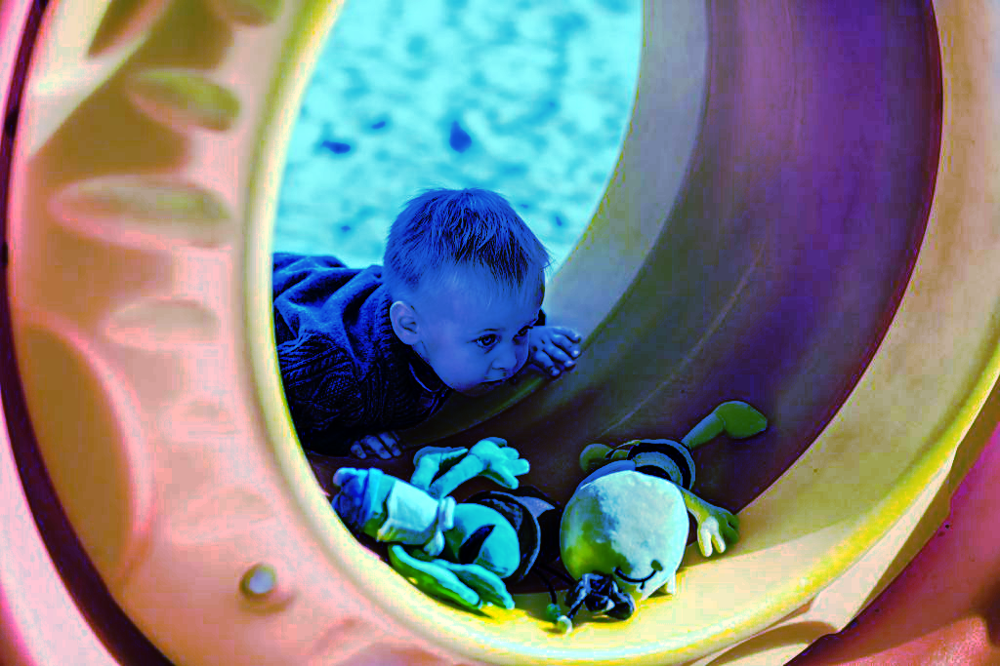

In [ ]:
print("Original Image")
cv2_imshow(img)
print("Updated Image")
cv2_imshow(out_image)

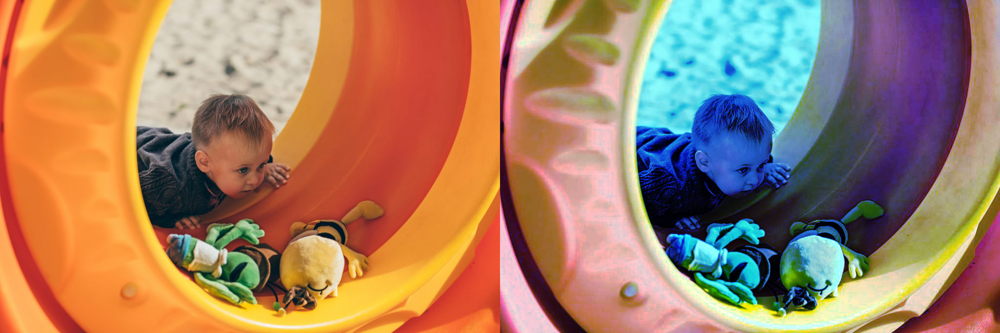

In [ ]:
#side by side comparison
merge_horizontal = np.hstack((img, out_image))
cv2_imshow(merge_horizontal)

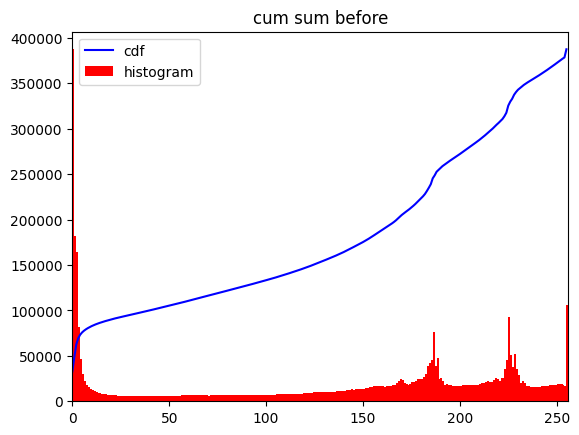

In [ ]:
## Histogram equalization on color images - Image 3
img = cv2.imread('images/eggs.jpg')

hist,bins = np.histogram(img.flatten(),256,[0,256])
cdf = hist.cumsum()
cdf_normalized = cdf * float(hist.max()) / cdf.max()
plt.plot(cdf_normalized, color = 'b')
plt.hist(img.flatten(),256,[0,256], color = 'r')
plt.xlim([0,256])
plt.legend(('cdf','histogram'), loc = 'upper left')
plt.title('cum sum before')
plt.show()

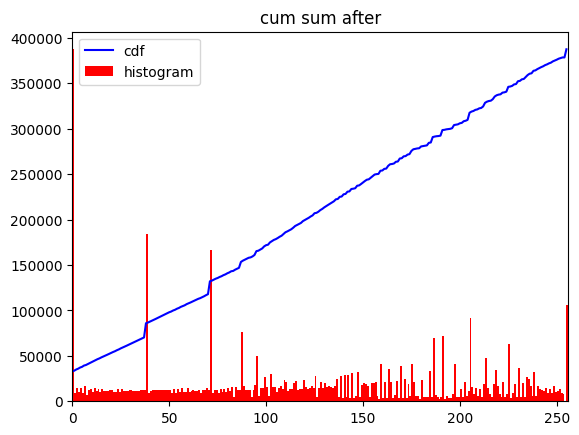

In [ ]:
out_image = histogram_equalization(img)

Original Image


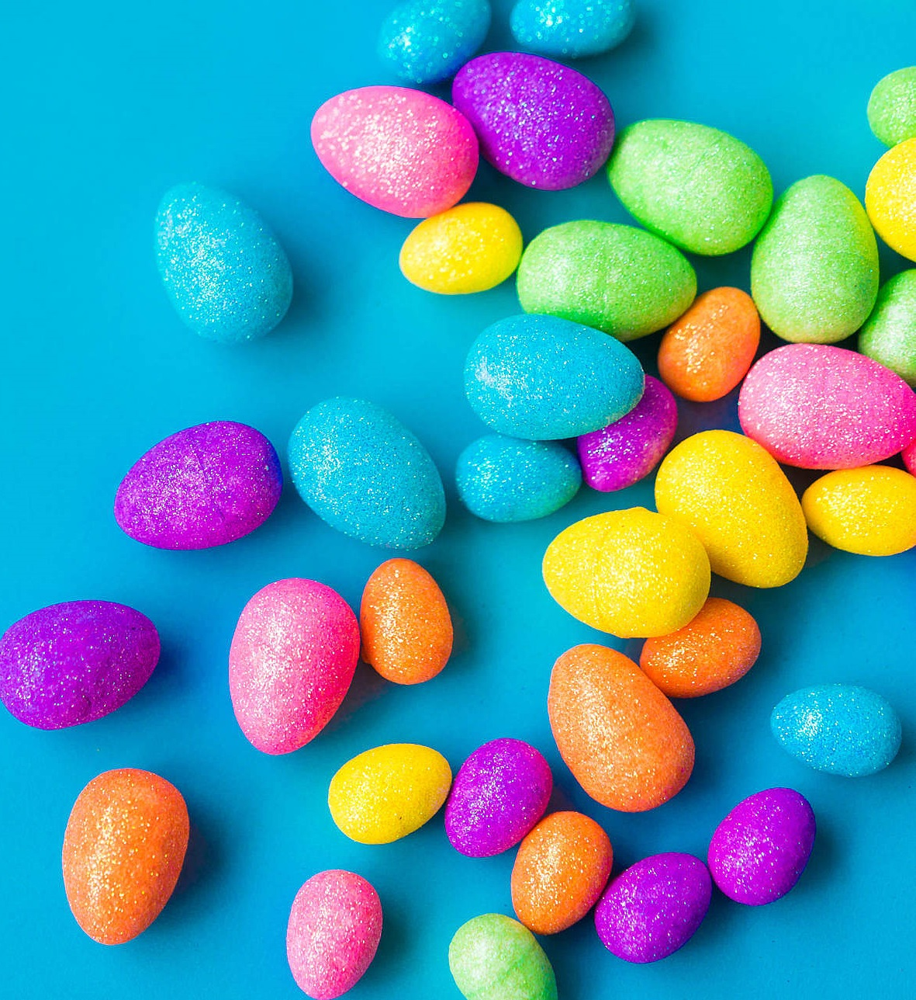

Updated Image


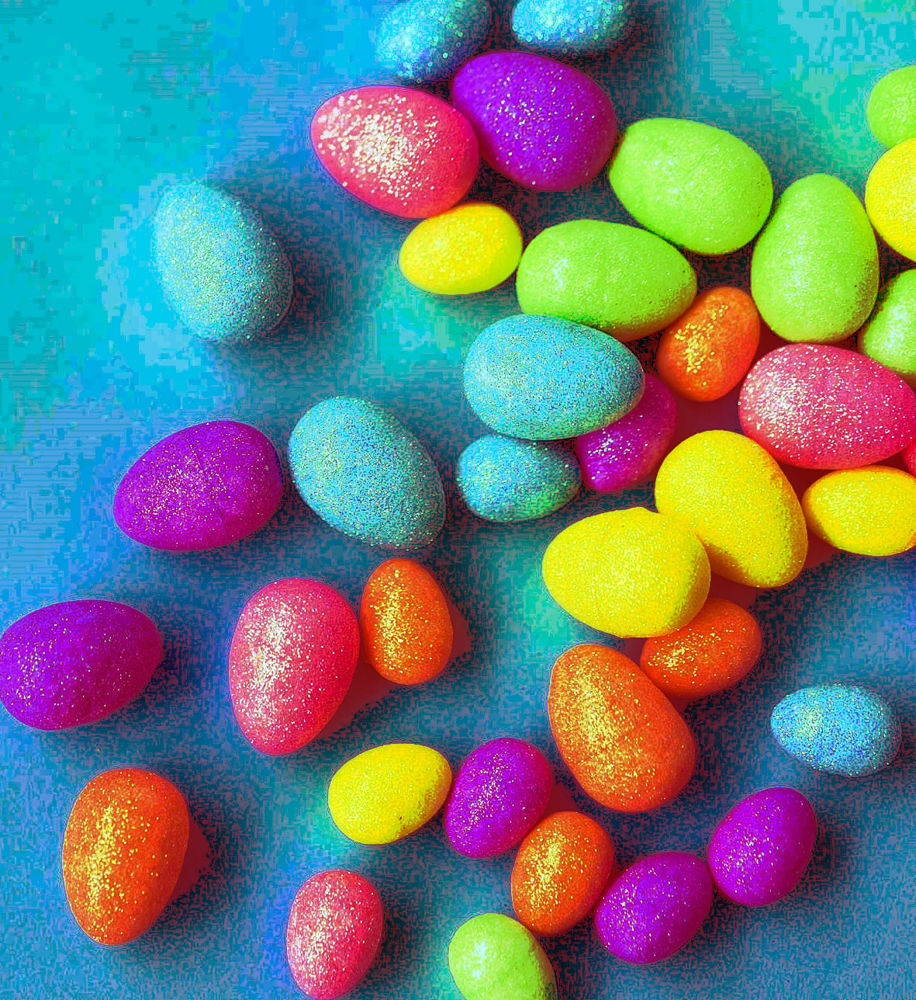

In [ ]:
print("Original Image")
cv2_imshow(img)
print("Updated Image")
cv2_imshow(out_image)

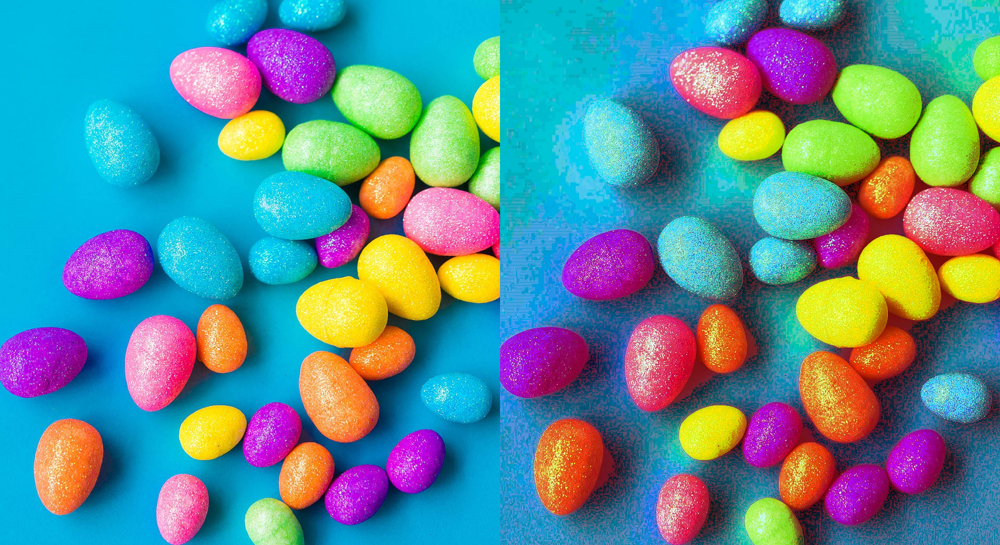

In [ ]:
#side by side comparison
merge_horizontal = np.hstack((img, out_image))
cv2_imshow(merge_horizontal)

## Question 2. Why don't we apply histogram equalization on each color channel separately to implement histogram equalization on color images?



```
# This is formatted as code
```

**Answer to Q2**: type your answer here


## Task 3. Convert RGB image to Ycbcr from opencv

Use any rgb image and share it from your google drive as shareable link and use it here

In [ ]:
#code here

In [ ]:
!gdown '1FNlolConJ9UC5pmGvWEeN0mwP51061Tk'

Downloading...
From: https://drive.google.com/uc?id=1FNlolConJ9UC5pmGvWEeN0mwP51061Tk
To: /content/ice6_task3.jpg
100% 185k/185k [00:00<00:00, 70.7MB/s]


Photo by <a href="https://unsplash.com/@ersinm?utm_source=unsplash&utm_medium=referral&utm_content=creditCopyText">Ersin Mandaliev</a> on <a href="https://unsplash.com/photos/CSbZSqinnJc?utm_source=unsplash&utm_medium=referral&utm_content=creditCopyText">Unsplash</a>


In [ ]:
#YCrCb = cv2.cvtColor(img, cv2.COLOR_BGR2YCR_CB) (# if input image is BGR)
#YCrCb = cv2.cvtColor(img, cv2.COLOR_RGB2YCrCb) (# if input image is RGB)

In [ ]:
#input image
img_bgr = cv2.imread('ice6_task3.jpg')
#can convert in RGB as cv2 reads in BGR
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

#bgr to Ycbcr
img_bgr_ycbcr = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2YCR_CB)

#rgb to Ycbcr
img_rgb_ycbcr = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2YCrCb)

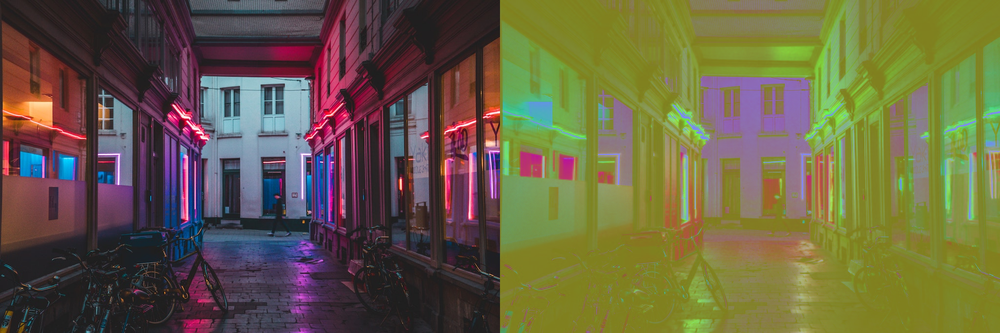

In [ ]:
#side by side comparison of BGR and YCbCr
merge_horizontal = np.hstack((img_bgr, img_bgr_ycbcr))
cv2_imshow(merge_horizontal)

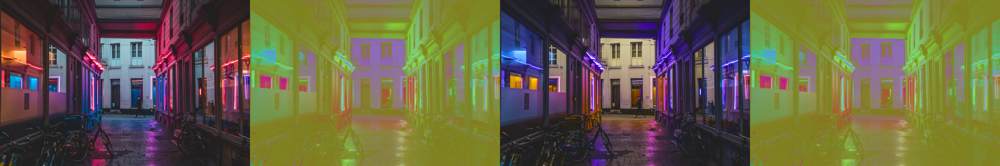

In [ ]:
#side by side comparison all 4 images BGR, BGR to YCbCr, BGR to RGB, RGB to YCbCr
merge_horizontal = np.hstack((img_bgr, img_bgr_ycbcr, img_rgb, img_rgb_ycbcr))
cv2_imshow(merge_horizontal)

## Task 4. Design code to implement Features from Accelerated Segment Test (FAST)

Keep your face image file name as **faceimg.jpg**
Save it in drive and use get shareable link to everyone option.

Please print the following during the implementation

* Original Image (faceimg.jpg)

* Gray Image (of original image)

* Number of Keypoints Detected In The Image With Non Max Suppression (Not just number image too)

* Number of Keypoints Detected In The Image Without Non Max Suppression (Not just number image too)


In [ ]:
#code here

In [ ]:
#!gdown '1-tv2LIl2EiKNXuR3Mkw-RRm7ylJGgQwt'

In [ ]:
!gdown '1FRYaJYBEjtnlM68fa5a3sY0IvJjgS3-D'

Downloading...
From: https://drive.google.com/uc?id=1FRYaJYBEjtnlM68fa5a3sY0IvJjgS3-D
To: /content/train1.jpg
100% 120k/120k [00:00<00:00, 87.8MB/s]


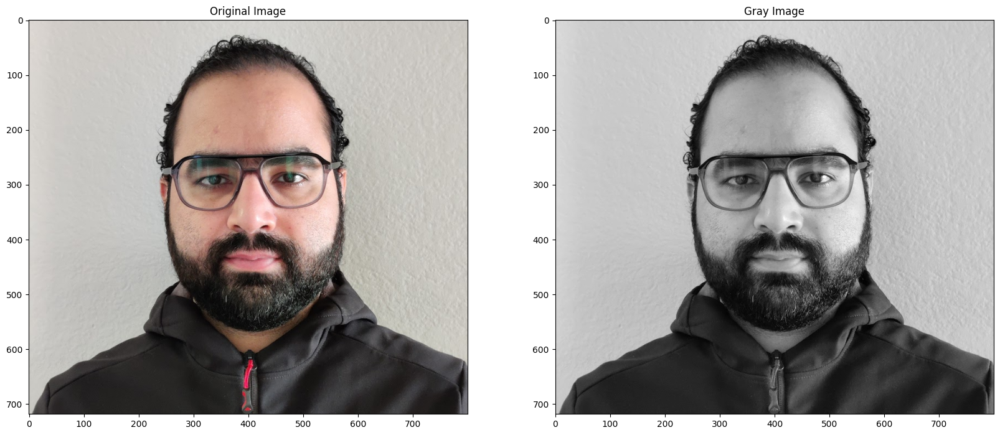

In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

# Load the image
image1 = cv2.imread('train1.jpg')

# Convert image to RGB
image = cv2.cvtColor(image1, cv2.COLOR_BGR2RGB)

# Convert image to gray scale
gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

# Display image and gray image
fx, plots = plt.subplots(1, 2, figsize=(20,10))

plots[0].set_title("Original Image")
plots[0].imshow(image)

plots[1].set_title("Gray Image")
plots[1].imshow(gray, cmap="gray")

Number of Keypoints Detected In The Image With Non Max Suppression:  6507
Number of Keypoints Detected In The Image Without Non Max Suppression:  18639


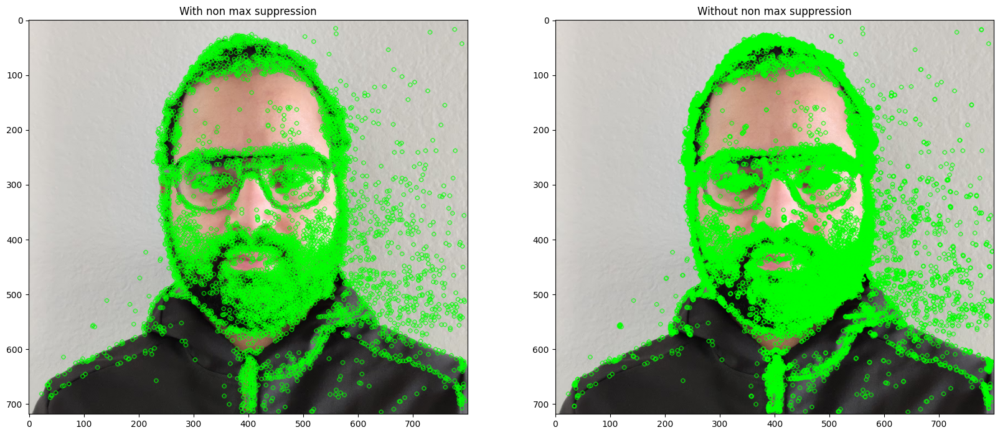

In [ ]:
fast = cv2.FastFeatureDetector_create()

# Detect keypoints with non max suppression
keypoints_with_nonmax = fast.detect(gray, None)

# Disable nonmaxSuppression
fast.setNonmaxSuppression(False)

# Detect keypoints without non max suppression
keypoints_without_nonmax = fast.detect(gray, None)

image_with_nonmax = np.copy(image)
image_without_nonmax = np.copy(image)

# Draw keypoints on top of the input image
cv2.drawKeypoints(image, keypoints_with_nonmax, image_with_nonmax, color=(0,255,0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2.drawKeypoints(image, keypoints_without_nonmax, image_without_nonmax, color=(0,255,0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# Display image with and without non max suppression
fx, plots = plt.subplots(1, 2, figsize=(20,10))

plots[0].set_title("With non max suppression")
plots[0].imshow(image_with_nonmax)

plots[1].set_title("Without non max suppression")
plots[1].imshow(image_without_nonmax)

# Print the number of keypoints detected in the training image
print("Number of Keypoints Detected In The Image With Non Max Suppression: ", len(keypoints_with_nonmax))

# Print the number of keypoints detected in the query image
print("Number of Keypoints Detected In The Image Without Non Max Suppression: ", len(keypoints_without_nonmax))

References:

https://medium.com/data-breach/introduction-to-fast-features-from-accelerated-segment-test-4ed33dde6d65

https://github.com/deepanshut041/feature-detection/blob/master/fast/fast.ipynb


## Question 3. Difference between MPEG 4 and MPEG 7

**Answer to Q3**: type your answer here


## Question 4.

Whats MPEG 21 ?

Whats the Purpose of MPEG 21 ?

Applications of MPEG 21?

**Answer to Q4**: type your answer here